# Loan Payments EDA Project

## Part 1 - Data Transformation

In [11]:
# Import the necessary functions and classes.
from db_connector import open_table

from data_transform import DataTransform

from data_frame_info import DataFrameInfo

from plotter import Plotter

from data_frame_transform import DataFrameTransform

In [12]:
# Retrieve loan payments table.
raw_table = open_table()

In [13]:
# Call methods and classes.

# Call the DataTransform class.
transform_call = DataTransform(raw_table)

# Remove strings from the 'term' column.
transform_call.remove_term_column_strings()

# Convert all date columns to datetime format.
transform_call.iterate_through_columns()

# Initialise a DataFrameInfo call with the raw dataframe.
find_info = DataFrameInfo(raw_table)

# Create table of percentage null values in the raw dataframe.
null_percentages_table = find_info.percentage_null_values()
display(null_percentages_table)


,percentage_null_values
mths_since_last_record,88.60
mths_since_last_major_derog,86.17
next_payment_date,60.13
mths_since_last_delinq,57.17
int_rate,9.53
term,8.80
funded_amount,5.54
employment_length,3.91
last_payment_date,0.13
collections_12_mths_ex_med,0.09


In [14]:
# Sort data based on the meta data.

# Columns with null values:
all_null_columns = ['mths_since_last_record', 'mths_since_last_major_derog', 'next_payment_date', 'mths_since_last_delinq', 'employment_length', 'last_payment_date', 'last_credit_pull_date', 'term', 'int_rate', 'funded_amount', 'collections_12_mths_ex_med']

 # Columns with >50% null values:
highest_null_proportion_columns = ['mths_since_last_record', 'mths_since_last_major_derog', 'next_payment_date', 'mths_since_last_delinq']

# Columns with <10% null values:
low_null_columns = ['int_rate', 'funded_amount', 'last_payment_date', 'last_credit_pull_date', 'collections_12_mths_ex_med']

# Categorical columns:
categorical_columns = ['employment_length', 'term'] # Contains null values

# Date columns
date_columns = ['last_payment_date', 'last_credit_pull_date'] # Contains null values


In [15]:
# Assess skewness of columns with low percentage null values.
low_null_skew = find_info.column_skew(low_null_columns)

display(low_null_skew)

int_rate                       0.412032
funded_amount                  0.821787
collections_12_mths_ex_med    20.252780
dtype: float64

In [16]:
# Sort the low percentage null columns by skewness.

# Columns with <1 skew:
low_skew_columns = ['int_rate', 'funded_amount']

# Columns with >1 skew:
high_skew_columns = ['collections_12_mths_ex_med']

# Remaining low null columns:
remaining_columns = ['int_rate', 'funded_amount']

In [17]:
# Initialise a dataframe transform call.
data_frame_transform_call = DataFrameTransform(raw_table)

In [18]:
# Remove the null values in the dataframe.

# Drop all columns with >50% null values.
data_frame_transform_call.drop_columns(highest_null_proportion_columns)

# Impute null values in categorical columns with the mode.
data_frame_transform_call.impute_with_mode(categorical_columns)

# Impute null values in columns with >1 skew with the median.
data_frame_transform_call.impute_with_median(high_skew_columns)

# Drop rows with null values in columns with <1% null values.
data_frame_transform_call.drop_rows(date_columns)

# Impute remaining null values in columns with <10% null values with the mean and initialise latest table.
no_null_table = data_frame_transform_call.impute_with_mean(remaining_columns)

<Axes: >

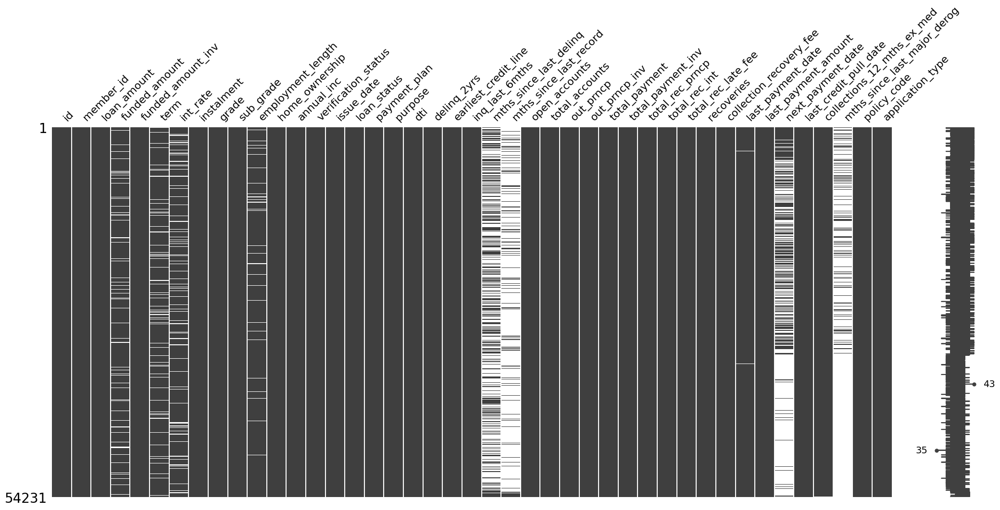

In [19]:
# Visualise missing values before removal of null values.

# Call the plotter class with the raw data frame and produce matrix.
visualise = Plotter(open_table())
visualise.missing_data()

<Axes: >

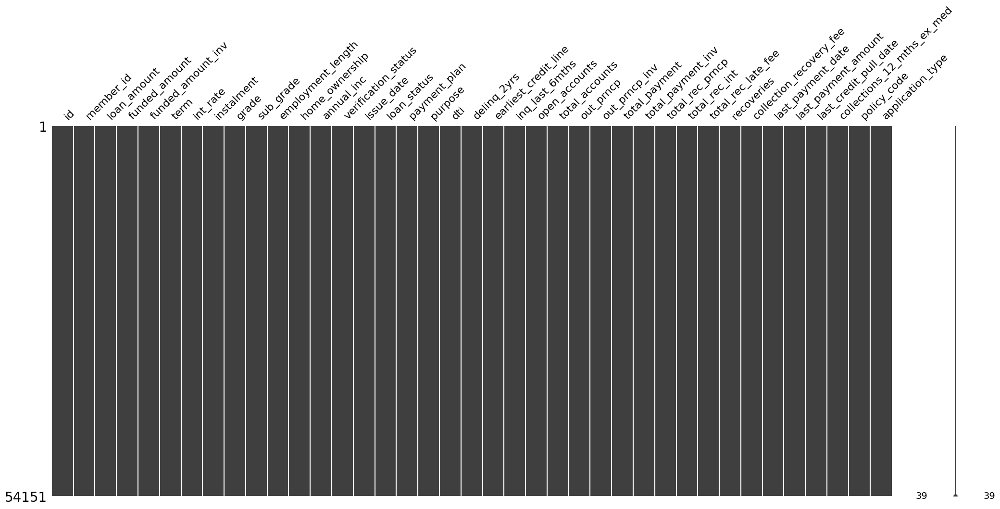

In [20]:
# Visualise data after missing value removal.

# Call the plotter class with the null-removed
visualise = Plotter(no_null_table)
visualise.missing_data()

id                             2.370227
member_id                      2.205248
loan_amount                    0.804922
funded_amount                  0.845191
funded_amount_inv              0.813376
term                           1.147782
int_rate                       0.398977
instalment                     0.996572
annual_inc                     8.717500
dti                            0.189101
delinq_2yrs                    5.376385
inq_last_6mths                 3.253523
open_accounts                  1.059184
total_accounts                 0.779040
out_prncp                      2.354051
out_prncp_inv                  2.354471
total_payment                  1.269875
total_payment_inv              1.257870
total_rec_prncp                1.262679
total_rec_int                  2.204585
total_rec_late_fee            13.174553
recoveries                    14.389299
collection_recovery_fee       27.807754
last_payment_amount            2.497220
collections_12_mths_ex_med    20.307695


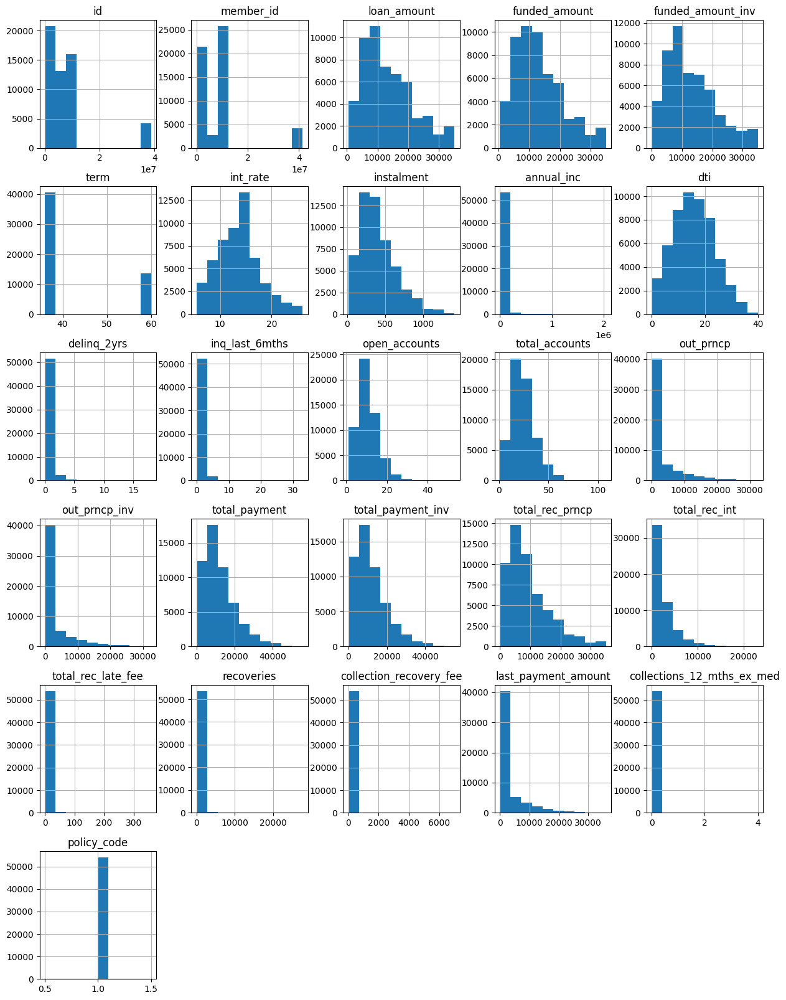

In [21]:
# Assess dataframe after null removal.

# Call DataFrameInfo class with latest dataframe.
new_info = DataFrameInfo(no_null_table)

# View data types within new dataframe.
new_table_data_types = new_info.find_column_types()

# Assess skew of new dataframe.
all_skew = new_info.column_skew()
display(all_skew)

# Visualise the skewness of the dataframe.
new_info.get_histogram()

# List all column names in the dataframe.
all_column_names = list(no_null_table)

# Call the DataFrameTransform class after removal of nulls in the dataframe.
transform_post_null_removal = DataFrameTransform(no_null_table)

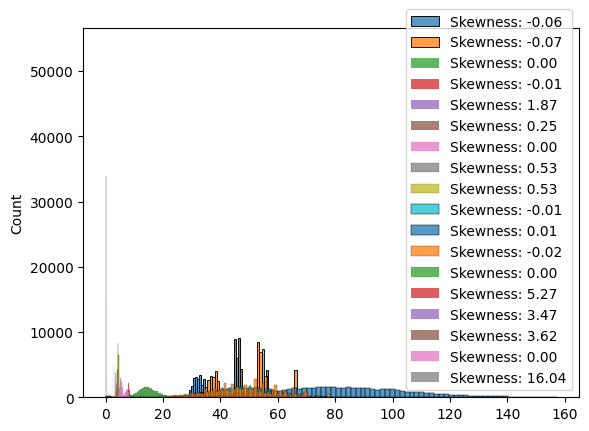

In [22]:
# Initialise DataFrameInfo with the latest table.
get_info = DataFrameInfo(no_null_table)

# Assess skewness of dataframe.
skew_table = get_info.column_skew()

# Transform columns with >1 skew and initialise final table transformation.
transformed_table = transform_post_null_removal.yeojohnson_transform(skew_table)

# Initialise DataFrameInfo class with final table transformation.
transform_info = DataFrameInfo(transformed_table)

# Assess skewness of transformed dataframe.
reduced_skew = transform_info.column_skew()

In [23]:
# Check skewness after transformation.
print(f'Before transformation:\n{skew_table}.\n After transformation:\n{reduced_skew}')

Before transformation:
id                             2.370227
member_id                      2.205248
loan_amount                    0.804922
funded_amount                  0.845191
funded_amount_inv              0.813376
term                           1.147782
int_rate                       0.398977
instalment                     0.996572
annual_inc                     8.717500
dti                            0.189101
delinq_2yrs                    5.376385
inq_last_6mths                 3.253523
open_accounts                  1.059184
total_accounts                 0.779040
out_prncp                      2.354051
out_prncp_inv                  2.354471
total_payment                  1.269875
total_payment_inv              1.257870
total_rec_prncp                1.262679
total_rec_int                  2.204585
total_rec_late_fee            13.174553
recoveries                    14.389299
collection_recovery_fee       27.807754
last_payment_amount            2.497220
collections_12_mt

### Outlier imputation.

In [24]:
# Call the DataFrameTransform class with the transformed table.
modify_data = DataFrameTransform(transformed_table)

# Impute outliers (z-score >3) with the median and initialise new table.
refined_table = modify_data.impute_outliers()

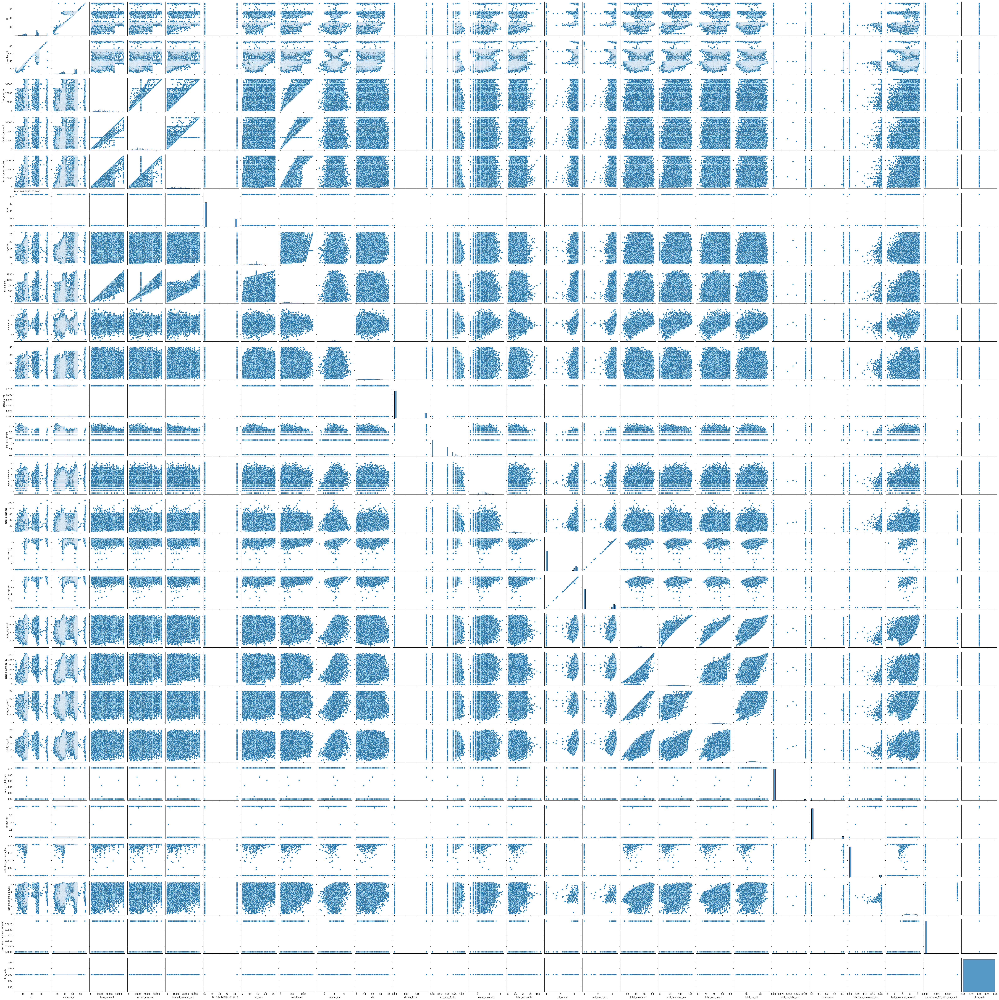

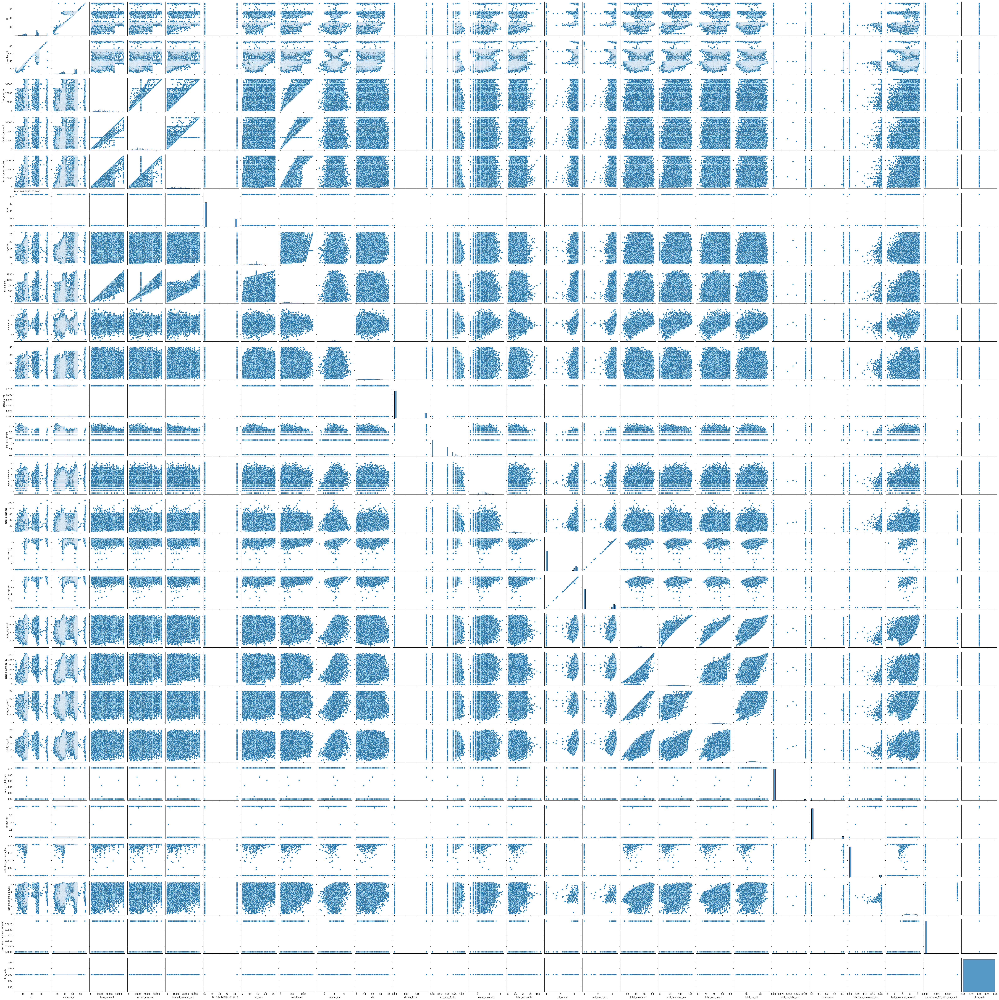

In [25]:
# Compare pair plots before and after imputing outliers.
transformed_data_plot = Plotter(transformed_table)
refined_data_plot = Plotter(refined_table)

transformed_data_plot.pair_plot()
refined_data_plot.pair_plot()

### Drop overly correlated columns.

In [26]:
# Visualise dataframe correlations.
refined_data_plot.correlation()

In [1]:
# Numeric columns with correlations scored at >0.9 that are able to be dropped without major impact to potential machine learning usage:
overly_correlated_columns = ['id', 'total_rec_prncp']

# Call the DataFrameTransform class with the outlier-imputed table.
transform_refined_data = DataFrameTransform(refined_table)

# Drop overly correlated columns from the dataframe and initialise final version of the table for use in machine learning if required.
clean_table = transform_refined_data.drop_columns(overly_correlated_columns)

NameError: name 'DataFrameTransform' is not defined